# _Transferencia de Estilo_ sobre sinusoides trackeadas

    * Técnica mixta (SMS + CNN)
    * Transformada SMS (Spectral Modelling Synthesis)
    * Style Transfer con CNN sobre parte sinusoidal
    * Reconstrucción (sumando residuo)


In [ ]:
import sys, os, functools, time

import numpy as np
import matplotlib.pyplot as plt

import librosa
import librosa.display
from IPython.display import Audio, display
from scipy.signal import hamming, triang, blackmanharris

%matplotlib inline

In [ ]:
# tmp
import sys
#sys.path.append(os.path.join(os.path.dirname(os.path.realpath('__file__')), './transferencia-estilo-sms/'))
sys.path.append(os.path.join(os.path.dirname(os.path.realpath('__file__')), '../'))
sys.path.append(os.path.join(os.path.dirname(os.path.realpath('__file__')), '../sms-tools-lite/software/models/'))

In [ ]:
# Métodos para Análisis/Síntesis: SMS, STFT, Log STFT, etc
from sms import *
from stft import *

# Métodos para plot en tiempo, espectrograma, sinusoides, etc
import visualizar

ModuleNotFoundError: ignored

In [ ]:
import tensorflow as tf
from sys import stderr

PROC_DEVICE = '/cpu:0' # CPU processor
#PROC_DEVICE = '/gpu:0' # For GPU implementation

In [ ]:
tf.__version__

'1.12.0'

## Configuración

In [ ]:
MAX_NUM_SINES = 16

ALPHA= .9e-2
#ALPHA= .4e-2 # más estilo

MAX_ITER =300

N_FILTERS = 4096 # cantidad de filtros
BATCH_SIZE = 1 # batch size
m = 1 # número de batch

FILTER_DIM = 11 # dimensión de los filtro

N_FFT = 2048 # cantidad de puntos de la fft

## Definición de estilo y contenido

In [ ]:
sys.path.append(os.path.join(os.path.dirname(os.path.realpath('__file__')), '../'))
CONTENIDO_FILENAME = "../extractos/ElChoclo_10s.wav"
ESTILO_FILENAME = "../extractos/AdiosNonino_10s.wav"

# SMS Análisis del Contenido ('El choclo')

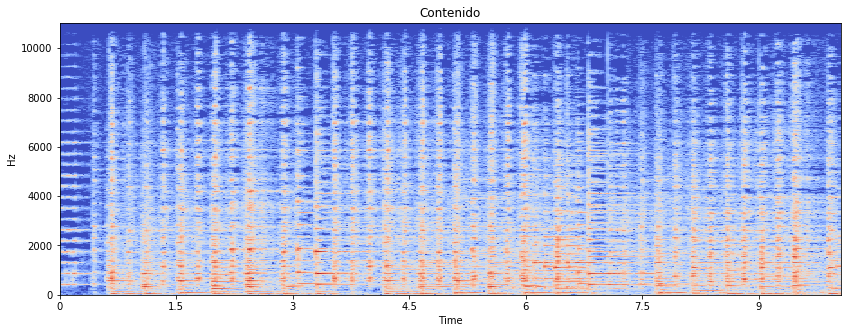

In [ ]:
visualizar.espectrograma_grande(CONTENIDO_FILENAME, "Contenido")

In [ ]:
#Contenido
tfreq, tmag, tphase, Fs = sms_analysis_from_file(CONTENIDO_FILENAME)
display(Audio(CONTENIDO_FILENAME), "Original")

#Sinusoides (del contenido)
CONTENIDO_SINUSOIDES_FILENAME = "contenido_sinusoides.wav"
y = sms_synth_to_file(CONTENIDO_SINUSOIDES_FILENAME, tfreq, tmag, tphase, Fs)

display(Audio(CONTENIDO_SINUSOIDES_FILENAME), "Sinusoides")

#Residuo
CONTENIDO_RESIDUAL_FILENAME = "./contenido_residual.wav"
x, Fs = librosa.load(CONTENIDO_FILENAME) #original
sinusoidal_part = np.concatenate([y, np.zeros(np.shape(x)[0]-np.shape(y)[0])]) # misma longitud para poder restar
residual = np.asarray( x-sinusoidal_part, dtype='float32' ) # original sound - sinusoidal part
librosa.output.write_wav(CONTENIDO_RESIDUAL_FILENAME, residual, Fs)

display(Audio(CONTENIDO_RESIDUAL_FILENAME), "Residuo")

#Reconstrucción
CONTENIDO_RECONSTR_FILENAME = "./sms_contenido_reconstruccion.wav"
x_reconstr = np.asarray( sinusoidal_part+residual, dtype='float32' ) # original sound - sinusoidal part
librosa.output.write_wav(CONTENIDO_RECONSTR_FILENAME, x_reconstr, Fs)

display(Audio(CONTENIDO_RECONSTR_FILENAME), "Reconstrucción")

contenido_X_FRAMES = x.shape[0]

'Original'

'Sinusoides'

'Residuo'

'Reconstrucción'

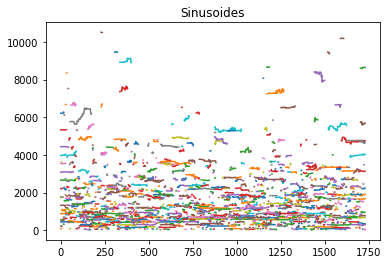

In [ ]:
f_tmp = tfreq
f_tmp[f_tmp<=0] = None
for num in range(MAX_NUM_SINES):
    plt.plot(f_tmp[:,num], 'C'+str(num%10))
plt.title("Sinusoides")
plt.show()

# SMS análisis del estilo

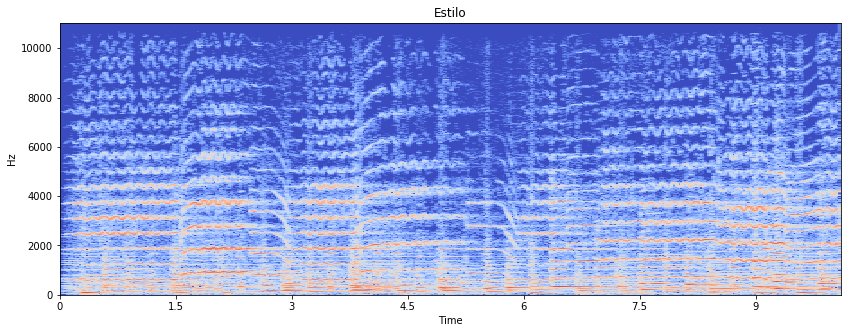

In [ ]:
visualizar.espectrograma_grande(ESTILO_FILENAME, "Estilo")

In [ ]:
tfreq, tmag, tphase, fs = sms_analysis_from_file(ESTILO_FILENAME)
display( Audio(ESTILO_FILENAME), "Original" )

#Sinusoides
ESTILO_SINUSOIDES_FILENAME = "estilo_sinusoides.wav"
y = sms_synth_to_file(ESTILO_SINUSOIDES_FILENAME, tfreq, tmag, tphase, Fs)

display(Audio(ESTILO_SINUSOIDES_FILENAME), "Sinusoides")

ESTILO_RESIDUAL_FILENAME = "./estilo_residual.wav"
x, Fs = librosa.load(ESTILO_FILENAME) #original
sinusoidal_part = np.concatenate([y, np.zeros(np.shape(x)[0]-np.shape(y)[0])]) # misma longitud para poder restar
residual = np.asarray( x-sinusoidal_part, dtype='float32' ) # original sound - sinusoidal part
librosa.output.write_wav(ESTILO_RESIDUAL_FILENAME, residual, Fs)


display(Audio(ESTILO_RESIDUAL_FILENAME), "Residuo")

#Reconstrucción
ESTILO_RECONSTR_FILENAME = "./sms_estilo_reconstruccion.wav"
x_reconstr = np.asarray( sinusoidal_part+residual, dtype='float32' ) # original sound - sinusoidal part
librosa.output.write_wav(ESTILO_RECONSTR_FILENAME, x_reconstr, Fs)

display(Audio(ESTILO_RECONSTR_FILENAME), "Reconstrucción")

estilo_X_FRAMES = x.shape[0]

'Original'

'Sinusoides'

'Residuo'

'Reconstrucción'

In [ ]:
N_SAMPLES = np.min([ contenido_X_FRAMES, estilo_X_FRAMES])

# audio_contenido y audio_estilo
a_contenido, Fs = logmag_stft_from_file(CONTENIDO_SINUSOIDES_FILENAME, X_FRAMES=N_SAMPLES, N_FFT=N_FFT)
a_estilo, Fs = logmag_stft_from_file(ESTILO_SINUSOIDES_FILENAME, X_FRAMES=N_SAMPLES)

N_SAMPLES = np.min([ a_contenido.shape[1], a_estilo.shape[1]])
N_HEIGHT = 1 # equivale al height de la imagen
N_CHANNELS = a_contenido.shape[0] # cantidad de muestras en frecuencia (channels) o columnas

# IMPORTANTE: se toman del estilo igual cantidad de samples y frecuencias que el contenido
a_estilo = a_estilo[:N_CHANNELS, :N_SAMPLES]
a_contenido = a_contenido[:N_CHANNELS, :N_SAMPLES]

Frames:  (1025, 433)
Frames:  (1025, 434)


# Comparativa de espectrogramas

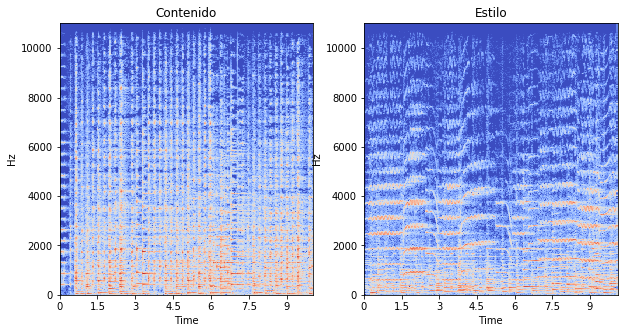

In [ ]:
visualizar.comparar_espectrogramas_grande(CONTENIDO_FILENAME, "Contenido", ESTILO_FILENAME, "Estilo" )

# Cálculo de los _features_ del contenido y del estilo

### Observaciones

* padding = 0 (VALID)
* stride = 1   ---> [batch, s_height, s_width, channel] ----> [1,1,1,1]
* x input es un placeholder

In [ ]:
# x input es un placeholder!
a_contenido_tf = np.ascontiguousarray(a_contenido.T[None,None,:,:])
a_estilo_tf = np.ascontiguousarray(a_estilo.T[None,None,:,:])

std = np.sqrt(2) * np.sqrt(2.0 / ((N_CHANNELS + N_FILTERS) * 11))

kernel = np.random.randn(1,FILTER_DIM, N_CHANNELS, N_FILTERS)*std

In [ ]:
g = tf.Graph()
with g.as_default(), g.device( PROC_DEVICE ), tf.Session() as sess:

    x = tf.placeholder('float32', [m,N_HEIGHT,N_SAMPLES,N_CHANNELS], name="x")

    W1 = tf.constant(kernel, dtype='float32')
    s = stride = 1 # [batch, s_height, s_width, channel] ----> [1,1,1,1]

    # Conv Layer
    conv = tf.nn.conv2d(x, W1, strides=[1, s, s, 1], padding="VALID")

    # max pooling
    #f = 3 #window
    #s = 1
    #P1 = tf.nn.max_pool(conv, ksize = [1,f,f,1], strides = [1,s,s,1], padding = 'SAME')

    #net = tf.nn.relu(P1)
    #ReLU (alinealidad)
    net = tf.nn.relu(conv)

    contenido_features = net.eval(feed_dict={x: a_contenido_tf}) #feat. del contenido
    estilo_features = net.eval(feed_dict={x: a_estilo_tf})

    # features del estilo -> se calcula la mastriz gram de estilo
    features = np.reshape(estilo_features, (-1, N_FILTERS))
    estilo_gram = np.matmul(features.T, features) / N_SAMPLES

# Costo que se minimiza


    costo = costo_contenido  +  costo_estilo

Distancia matemática entre

* costo_contenido = distancia( Contenido y Resultado )
* costo_estilo = distancia( Estilo y Resultado )

In [ ]:
result = None
with tf.Graph().as_default():

    # Inicializado en random
    x = tf.Variable( np.random.randn(1,1,N_SAMPLES,N_CHANNELS).astype(np.float32)*1e-3, name="x" )

    # filtro o kernel
    kernel_tf = tf.constant(kernel, name="kernel", dtype='float32') # el kernel se define más arriba de forma random

    # Conv Layer
    conv = tf.nn.conv2d(x,kernel_tf, strides=[1, 1, 1, 1], padding="VALID", name="conv")

    # max pooling
    #f = 3 #window
    #s = 1
    #P1 = tf.nn.max_pool(conv, ksize = [1,f,f,1], strides = [1,s,s,1], padding = 'SAME')

    #net = tf.nn.relu(P1)
    #ReLU
    net = tf.nn.relu(conv)

    #Costo que se minimiza
    contenido_loss = ALPHA * 2 * tf.nn.l2_loss(
            net - contenido_features)

    estilo_loss = 0

    _, height, width, number = map(lambda i: i.value, net.get_shape())

    size = height * width * number
    feats = tf.reshape(net, (-1, number))
    gram = tf.matmul(tf.transpose(feats), feats)  / N_SAMPLES
    estilo_loss = 2 * tf.nn.l2_loss(gram - estilo_gram)

     # Overall loss
    loss = contenido_loss + estilo_loss

    opt = tf.contrib.opt.ScipyOptimizerInterface(
          loss, method='L-BFGS-B', options={'maxiter': MAX_ITER})

    init = tf.global_variables_initializer()

    # Optimization
    with tf.Session() as sess:
        sess.run(init)

        print('Started optimization.')
        opt.minimize(sess)

        print('Final loss:', loss.eval())
        result = x.eval()

Started optimization.
INFO:tensorflow:Optimization terminated with:
  Message: b'STOP: TOTAL NO. of ITERATIONS EXCEEDS LIMIT'
  Objective function value: 343.591980
  Number of iterations: 301
  Number of functions evaluations: 315
Final loss: 343.59198


# Inversión del espectrograma de las sinusoides con estilo aplicado

    * Algoritmo de Griffin-Lim para reconstruir la fase
    * exp(val) -1, porque antes se toma log+1 de la magnitud

In [ ]:
x = reconstruccion_fase_griffin_lim(result, a_contenido)

OUTPUT_FILENAME = 'sinusoides_out.wav'
librosa.output.write_wav(OUTPUT_FILENAME, x, fs)

# Primera reconstrucción (sin residuo)

In [ ]:
sinusoidal_part = x
display(Audio(OUTPUT_FILENAME), "Reconstruido (sin residuo)")

'Reconstruido (sin residuo)'

In [ ]:
residual, Fs = librosa.load(CONTENIDO_RESIDUAL_FILENAME)
residual_estilo, Fs = librosa.load(ESTILO_RESIDUAL_FILENAME)

K_len = np.min([ sinusoidal_part.shape[0],residual.shape[0], residual_estilo.shape[0] ])
print("Frames: ",K_len)

CONTENIDO_RECONSTR_FILENAME = "./contenido_estilo_sobre_sinusoides_con_residuo_original.wav"

# se agrega solo el residuo original
x_reconstr = np.asarray( sinusoidal_part[:K_len]+residual[:K_len], dtype='float32' ) # original sound - sinusoidal part

librosa.output.write_wav(CONTENIDO_RECONSTR_FILENAME, x_reconstr, Fs)

display( Audio(CONTENIDO_FILENAME), "Original")
display( Audio(ESTILO_FILENAME), "Estilo")
display( Audio(CONTENIDO_RECONSTR_FILENAME), "Reconstrucción con estilo aplicado y residuo original")
display( Audio(OUTPUT_FILENAME), "Reconstruido (sin residuo)")

Frames:  221184


'Original'

'Estilo'

'Reconstrucción con estilo aplicado y residuo original'

'Reconstruido (sin residuo)'

# Espectrogramas finales

Frames:  (1025, 433)


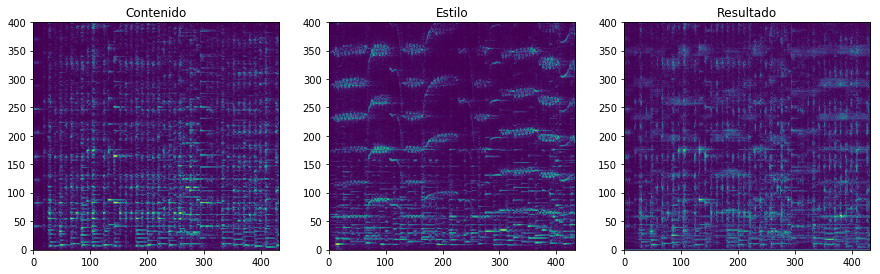

In [ ]:
a_recon, Fs = logmag_stft_from_file(CONTENIDO_RECONSTR_FILENAME, X_FRAMES=N_SAMPLES)
visualizar.comparar_3_espectrogramas(a_contenido, a_estilo, a_recon, MAX_FREC_BINS=400)

# Conclusiones preliminares
   
    * Bien _mezclado_ (contenido y estilo)
    * Se percibe de baja calidad
    * Opcional sumar residuo original y/o el del estilo
    * Resultado similar al obtenido aplicando la STFT a todo el archivo, pero un parámetro más de configuración